In [1]:
#import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.templates.default = "plotly_dark"
from plotly.subplots import make_subplots
import folium 
from folium import plugins
from tqdm.notebook import tqdm as tqdm
%matplotlib inline
from matplotlib import pyplot as plt

In [2]:
#read the dataset
df =  pd.read_csv("owid-covid-data.csv",parse_dates=[3])

In [3]:
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
0,AFG,Asia,Afghanistan,2020-02-24,1.0,1.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
1,AFG,Asia,Afghanistan,2020-02-25,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
2,AFG,Asia,Afghanistan,2020-02-26,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
3,AFG,Asia,Afghanistan,2020-02-27,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
4,AFG,Asia,Afghanistan,2020-02-28,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511


In [4]:
df.shape #the dataset shape

(71695, 59)

In [5]:
df.describe()  # statistical description of numerical features

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
count,7.073400e+04,70732.000000,69731.000000,6.166600e+04,61824.000000,69731.000000,70347.000000,70345.000000,69349.000000,61292.000000,...,65409.000000,44674.000000,66008.000000,66839.000000,51953.000000,51240.000000,33117.000000,60484.000000,68125.000000,65994.000000
mean,6.034023e+05,5106.971314,5123.648354,1.824010e+04,131.342230,115.109619,7094.345216,64.770593,64.684746,169.781157,...,19143.522522,13.250658,257.041670,7.792551,10.560718,32.650308,51.031005,3.037967,73.141170,0.728141
std,4.262034e+06,32210.604733,31959.662141,1.062040e+05,721.442088,657.453468,14074.062641,166.394200,139.492157,303.966794,...,19686.822836,19.910690,118.364826,3.928749,10.413123,13.462190,31.769299,2.468151,7.551426,0.150158
min,1.000000e+00,-46076.000000,-1121.714000,1.000000e+00,-1918.000000,-232.143000,0.001000,-2153.437000,-276.825000,0.001000,...,661.240000,0.100000,79.370000,0.990000,0.100000,7.700000,1.188000,0.100000,53.280000,0.394000
25%,6.990000e+02,1.000000,5.714000,3.500000e+01,0.000000,0.000000,135.660500,0.126000,0.969000,5.403000,...,4466.507000,0.500000,167.295000,5.290000,1.900000,21.600000,20.859000,1.300000,67.440000,0.602000
50%,7.499000e+03,57.000000,68.714000,2.350000e+02,2.000000,1.000000,1011.382000,6.089000,8.081000,29.304000,...,12951.839000,2.000000,242.648000,7.110000,6.300000,31.400000,49.839000,2.400000,74.530000,0.748000
75%,8.173600e+04,655.000000,682.071500,2.217750e+03,16.000000,12.000000,6460.442000,54.030000,61.376000,178.921000,...,27216.445000,21.200000,329.635000,10.080000,19.300000,41.100000,83.241000,4.000000,78.730000,0.848000
max,1.137847e+08,879905.000000,738686.000000,2.525401e+06,17845.000000,14379.286000,140412.865000,8652.658000,2648.773000,2180.447000,...,116935.600000,77.600000,724.417000,30.530000,44.000000,78.100000,98.999000,13.800000,86.750000,0.957000


In [6]:
#time field
print (df.loc[0]['date'],df.loc[2590]['date'])

2020-02-24 00:00:00 2020-01-31 00:00:00


**The time field/line for this dataset is one year which is not good in case of forcasting because we won't detect any big difference in economic indicators**

## Data Preprocessing

**Data Cleaning**

In [7]:
#check for missing values

df_null =df.isna().sum(); pr=df.isna().sum()/len(df)
Nan= pd.concat([df_null,pr], axis=1, keys=["df" ,"percentage"]) ; Nan

,df,percentage
iso_code,0,0.000000
continent,3562,0.049683
location,0,0.000000
date,0,0.000000
total_cases,961,0.013404
new_cases,963,0.013432
new_cases_smoothed,1964,0.027394
total_deaths,10029,0.139884
new_deaths,9871,0.137680
new_deaths_smoothed,1964,0.027394


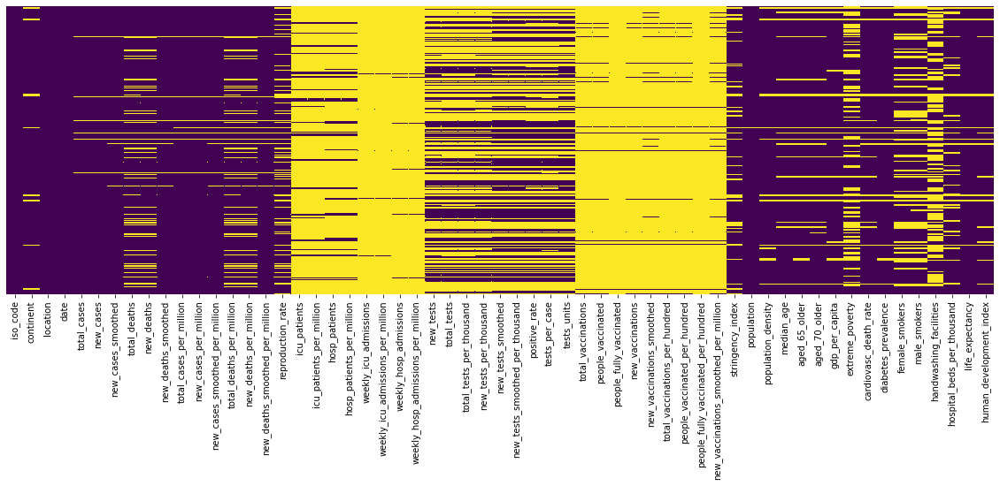

In [8]:
#visualizing nulls before cleaning
plt.figure(figsize=(20,6))
sns.heatmap(df.isnull(), cbar=False,cmap='viridis',yticklabels=False);
#Each empty entry in a column is represented by yellow color

**As we see above, there is a lot of missing values in our data, we will drop columns with more than 60% of missing values**

In [9]:
columns_to_drop = Nan[Nan['percentage']> 0.60]
columns_to_drop.index

Index(['icu_patients', 'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'new_vaccinations_smoothed', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'new_vaccinations_smoothed_per_million'],
      dtype='object')

In [10]:
#drop columns with most nan
df.drop(['icu_patients', 'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'new_vaccinations_smoothed', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'new_vaccinations_smoothed_per_million'], axis=1, inplace=True) 

In [11]:
df.shape

(71695, 42)

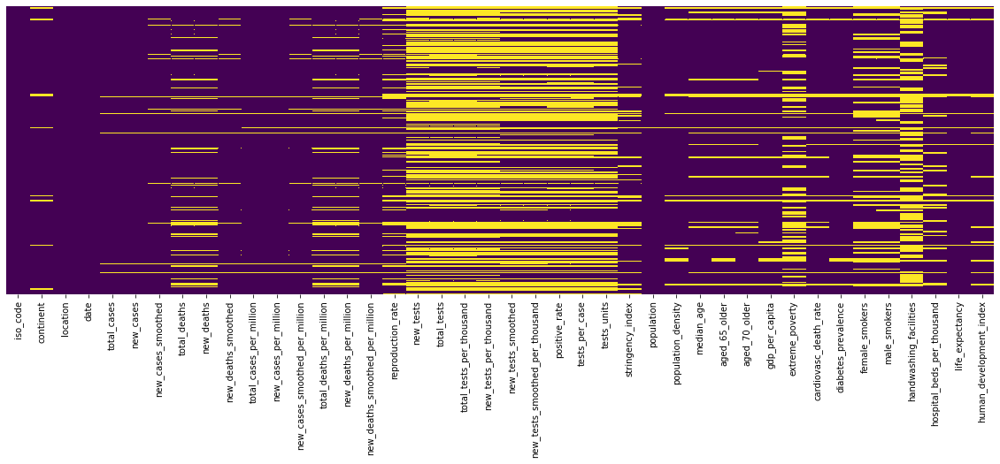

In [12]:
plt.figure(figsize=(20,6))
sns.heatmap(df.isnull(), cbar=False,cmap='viridis',yticklabels=False);

In [13]:
df_null =df.isna().sum(); pr=df.isna().sum()/len(df)
Nan= pd.concat([df_null,pr], axis=1, keys=["df" ,"percentage"]) ; Nan

,df,percentage
iso_code,0,0.000000
continent,3562,0.049683
location,0,0.000000
date,0,0.000000
total_cases,961,0.013404
new_cases,963,0.013432
new_cases_smoothed,1964,0.027394
total_deaths,10029,0.139884
new_deaths,9871,0.137680
new_deaths_smoothed,1964,0.027394


**In this stage of data cleaning, we will try to fill the rest of Nan values with mean or median for numerical variables. For the categorical varaibles we have ('tests_units','iso_code','continent','location'), these are useless to compute by the mode so it would be better to remove observations with nans for these columns.**


In [14]:
df.shape #most of our variables are numeric

(71695, 42)

In [15]:
#remove raws with nans in test_units 
df = df[df['tests_units'].notna()]

In [16]:
df['tests_units'].isna().sum()

0

In [17]:
#before we compute Nans for numerical variables lets have a look on the distribution of each numerical var
#extract numerical variables 
df_numeric = df._get_numeric_data()


df_numeric

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
751,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
752,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
753,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
754,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
755,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11803.431,1.1,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71688,35796.0,28.0,89.143,1436.0,4.0,5.143,2408.409,1.884,5.998,96.616,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.70,61.49,0.571
71689,35862.0,66.0,91.429,1441.0,5.0,4.429,2412.849,4.441,6.151,96.953,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.70,61.49,0.571
71690,35910.0,48.0,85.000,1448.0,7.0,4.857,2416.079,3.230,5.719,97.424,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.70,61.49,0.571
71691,35960.0,50.0,76.714,1456.0,8.0,5.429,2419.443,3.364,5.161,97.962,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.70,61.49,0.571


**Most of the numeric data is skewed, so it's better to impute missing values with the median**

In [18]:
#impute nan by the median
df_numeric.fillna(df_numeric.median(), inplace=True)
df_numeric.isna().sum()

total_cases                        0
new_cases                          0
new_cases_smoothed                 0
total_deaths                       0
new_deaths                         0
new_deaths_smoothed                0
total_cases_per_million            0
new_cases_per_million              0
new_cases_smoothed_per_million     0
total_deaths_per_million           0
new_deaths_per_million             0
new_deaths_smoothed_per_million    0
reproduction_rate                  0
new_tests                          0
total_tests                        0
total_tests_per_thousand           0
new_tests_per_thousand             0
new_tests_smoothed                 0
new_tests_smoothed_per_thousand    0
positive_rate                      0
tests_per_case                     0
stringency_index                   0
population                         0
population_density                 0
median_age                         0
aged_65_older                      0
aged_70_older                      0
g

In [19]:
#extract categorical features
df_categorical = df[['iso_code','continent','location','tests_units','date']]
df_categorical

,iso_code,continent,location,tests_units,date
751,ALB,Europe,Albania,tests performed,2020-02-25
752,ALB,Europe,Albania,tests performed,2020-02-26
753,ALB,Europe,Albania,tests performed,2020-02-27
754,ALB,Europe,Albania,tests performed,2020-02-28
755,ALB,Europe,Albania,tests performed,2020-02-29
...,...,...,...,...,...
71688,ZWE,Africa,Zimbabwe,tests performed,2021-02-21
71689,ZWE,Africa,Zimbabwe,tests performed,2021-02-22
71690,ZWE,Africa,Zimbabwe,tests performed,2021-02-23
71691,ZWE,Africa,Zimbabwe,tests performed,2021-02-24


In [20]:
#concat df_numeric and df_categorical to have the df_cleaned(without Nans)
df_cleaned = pd.concat([df_numeric,df_categorical], axis=1)
df_cleaned.head()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,iso_code,continent,location,tests_units,date
751,26283.0,245.0,273.0,496.0,4.0,3.571,2195.126,17.915,19.9365,51.3485,...,51.2,59.607,2.89,78.57,0.795,ALB,Europe,Albania,tests performed,2020-02-25
752,26283.0,245.0,273.0,496.0,4.0,3.571,2195.126,17.915,19.9365,51.3485,...,51.2,59.607,2.89,78.57,0.795,ALB,Europe,Albania,tests performed,2020-02-26
753,26283.0,245.0,273.0,496.0,4.0,3.571,2195.126,17.915,19.9365,51.3485,...,51.2,59.607,2.89,78.57,0.795,ALB,Europe,Albania,tests performed,2020-02-27
754,26283.0,245.0,273.0,496.0,4.0,3.571,2195.126,17.915,19.9365,51.3485,...,51.2,59.607,2.89,78.57,0.795,ALB,Europe,Albania,tests performed,2020-02-28
755,26283.0,245.0,273.0,496.0,4.0,3.571,2195.126,17.915,19.9365,51.3485,...,51.2,59.607,2.89,78.57,0.795,ALB,Europe,Albania,tests performed,2020-02-29


In [21]:
#double check for Nans
print(df_cleaned.shape)
print('After cleaning our data we have a shape of (38495, 42) out of (71695, 59) in the original which indicates that we had a lot missing data for the feartures continent,location,isocode.These features cannot be imputed by the mode because they represent some sort of id for each observation')
df_cleaned.isna().sum()

(38495, 42)
After cleaning our data we have a shape of (38495, 42) out of (71695, 59) in the original which indicates that we had a lot missing data for the feartures continent,location,isocode.These features cannot be imputed by the mode because they represent some sort of id for each observation


total_cases                        0
new_cases                          0
new_cases_smoothed                 0
total_deaths                       0
new_deaths                         0
new_deaths_smoothed                0
total_cases_per_million            0
new_cases_per_million              0
new_cases_smoothed_per_million     0
total_deaths_per_million           0
new_deaths_per_million             0
new_deaths_smoothed_per_million    0
reproduction_rate                  0
new_tests                          0
total_tests                        0
total_tests_per_thousand           0
new_tests_per_thousand             0
new_tests_smoothed                 0
new_tests_smoothed_per_thousand    0
positive_rate                      0
tests_per_case                     0
stringency_index                   0
population                         0
population_density                 0
median_age                         0
aged_65_older                      0
aged_70_older                      0
g

**Data Visualization & Analysis**

In [22]:
#let s visualize total_cases,total_deaths,total_tests and population for each country to have an idea about the covid19 impact

#create a dataframe for total cases
totalcases = pd.DataFrame(df_cleaned.groupby('location')['total_cases'].sum())
totalcases['location'] = totalcases.index
#create a dataframe for total deaths
totaldeaths = pd.DataFrame(df_cleaned.groupby('location')['total_deaths'].sum())
totaldeaths['location'] = totaldeaths.index
#create a dataframe for total tests
totaltests = pd.DataFrame(df_cleaned.groupby('location')['total_tests'].sum())
totaltests['location'] = totaltests.index
#create a dataframe for population
totalpop = pd.DataFrame(df_cleaned.groupby('location')['population'].sum())
totalpop['location'] = totalpop.index


global_totalcases = totalcases[['location','total_cases']]
global_totaldeaths = totaldeaths[['location','total_deaths']]
global_totaltests = totaltests[['location','total_tests']]
global_totalpop = totalpop[['location','population']]

#plot the results

fig = px.bar(global_totalcases.sort_values('total_cases',ascending=False)[:20][::-1],x='total_cases',y='location',title='Total Cases Worldwide',text='total_cases', height=900, orientation='h')
fig.show()

fig = px.bar(global_totaldeaths.sort_values('total_deaths',ascending=False)[:20][::-1],x='total_deaths',y='location',title='Total Deaths Worldwide',text='total_deaths', height=900, orientation='h')
fig.show()

fig = px.bar(global_totaltests.sort_values('total_tests',ascending=False)[:20][::-1],x='total_tests',y='location',title='Total Tests Worldwide',text='total_tests', height=900, orientation='h')
fig.show()

fig = px.bar(global_totalpop.sort_values('population',ascending=False)[:20][::-1],x='population',y='location',title='Population Worldwide',text='population', height=900, orientation='h')
fig.show()

**From the plots above we can understand that :**

- The USA has the most covid-19 total cases, followed by India, Russia and France in top 4
- The USA has the most covid-19 total deaths, followed by India , Mexico and the UK  in top 4 
- The USA has the most covid-19 total tests, followed by India, Russia and the UK in top 4, when Mexico 
  is not even in the top 10 despite the horrible number of deaths.
- For the rest of the world, we can clearly notice a huge difference in having tests compared to top 4 above

**Now, we want to see more than just numbers, now, let's visualize total_cases, total_deaths, total_tests and gdp_per_capita (to have an idea about the impact on economy) over time**

## Correlation Between New tests and Deaths

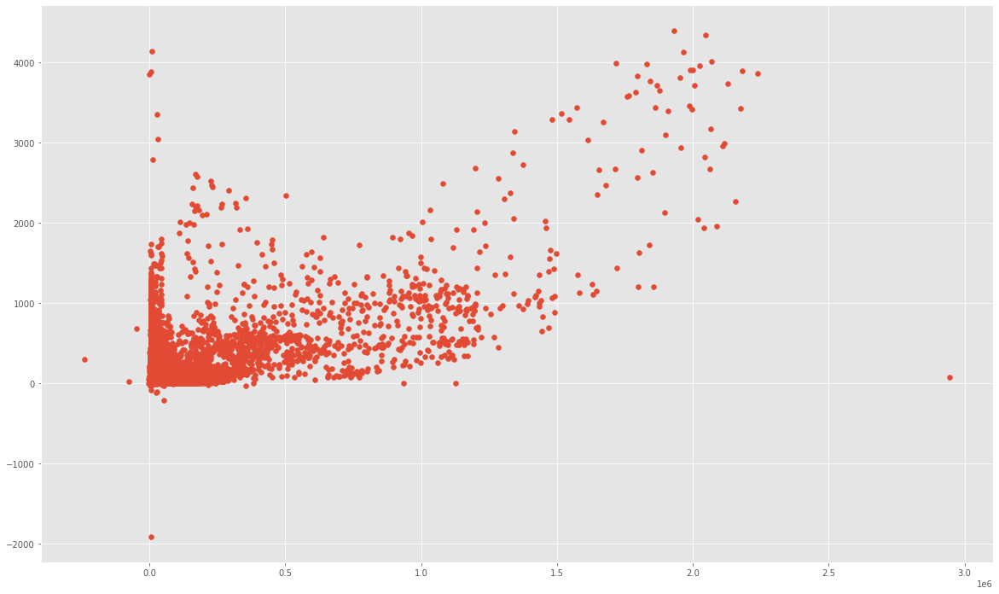

In [23]:
df= df_cleaned[['new_tests','new_deaths']]
plt.figure(figsize=(20,12))
plt.style.use('ggplot')

plt.scatter(df_cleaned['new_tests'], df_cleaned['new_deaths'])
plt.show()

## Correlation Between New cases and Deaths

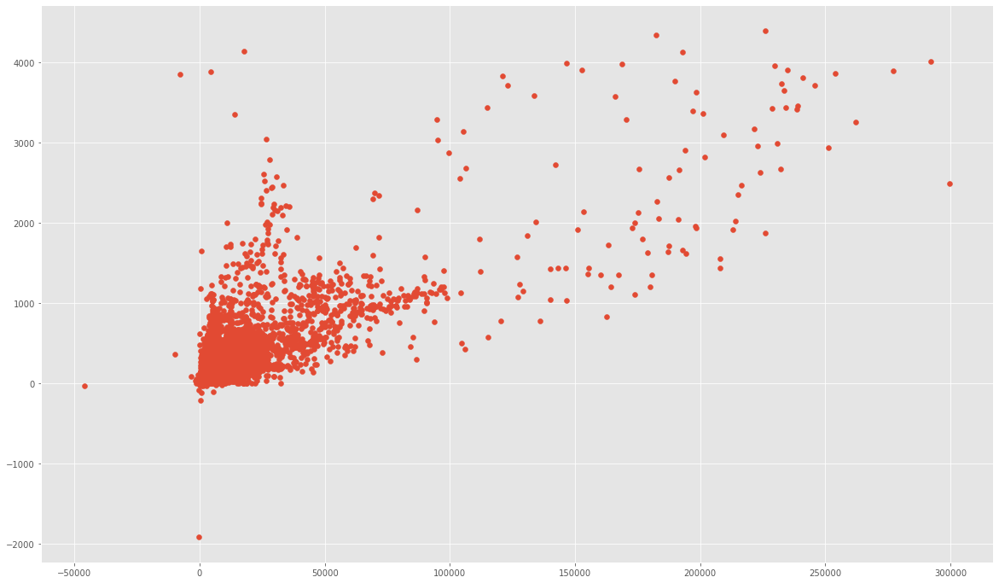

In [24]:
df= df_cleaned[['new_cases','new_deaths']]
plt.figure(figsize=(20,12))
plt.style.use('ggplot')

plt.scatter(df_cleaned['new_cases'], df_cleaned['new_deaths'])
plt.show()

## Correlation Between New tests and cases

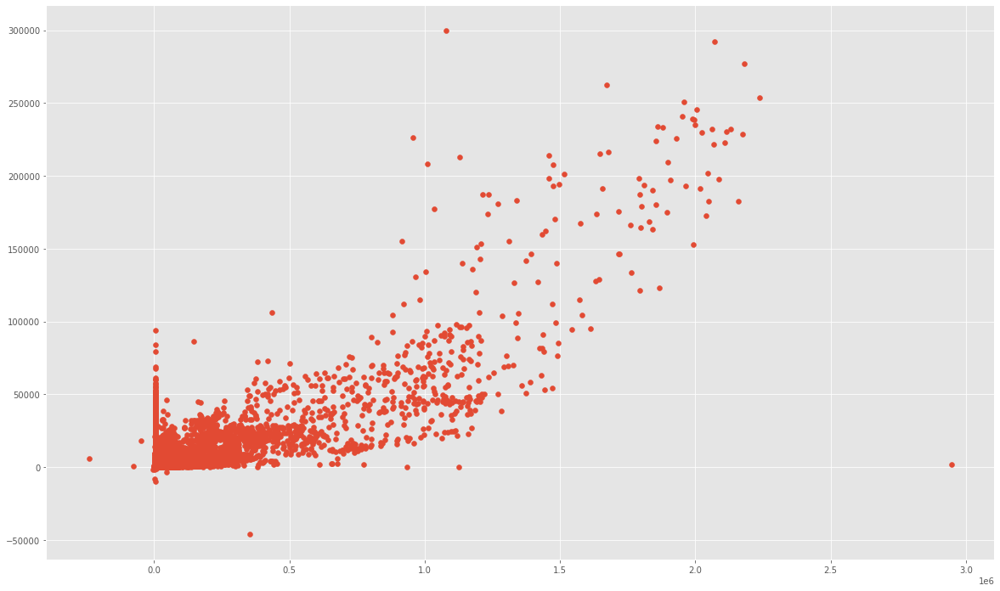

In [25]:
df= df_cleaned[['new_tests','new_cases']]
plt.figure(figsize=(20,12))
plt.style.use('ggplot')

plt.scatter(df_cleaned['new_tests'], df_cleaned['new_cases'])
plt.show()

In [26]:
#total_cases over time
totalcasesovertime = df_cleaned.groupby(['date', 'location'])['total_cases'].max()
totalcasesovertime = totalcasesovertime.reset_index()
totalcasesovertime['date'] = pd.to_datetime(totalcasesovertime['date'])
totalcasesovertime['date'] = totalcasesovertime['date'].dt.strftime('%m/%d/%Y')
totalcasesovertime['size'] = totalcasesovertime['total_cases'].pow(0.3)

fig = px.scatter_geo(totalcasesovertime, locations="location", locationmode='country names', 
                     color="total_cases", size='size', hover_name="location", 
                     range_color= [0, 10000000], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Total Cases Over Time', color_continuous_scale="portland")
fig.show()

#total_deaths over time
totaldeathsovertime = df_cleaned.groupby(['date', 'location'])['total_deaths'].max()
totaldeathsovertime = totaldeathsovertime.reset_index()
totaldeathsovertime['date'] = pd.to_datetime(totaldeathsovertime['date'])
totaldeathsovertime['date'] = totaldeathsovertime['date'].dt.strftime('%m/%d/%Y')
totaldeathsovertime['size'] = totaldeathsovertime['total_deaths'].pow(0.3)

fig = px.scatter_geo(totaldeathsovertime, locations="location", locationmode='country names', 
                     color="total_deaths", size='size', hover_name="location", 
                     range_color= [0, 100000], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Total Deaths Over Time', color_continuous_scale="portland")
fig.show()

#total_tests over time
totaltestssovertime = df_cleaned.groupby(['date', 'location'])['total_tests'].max()
totaltestssovertime = totaltestssovertime.reset_index()
totaltestssovertime['date'] = pd.to_datetime(totaltestssovertime['date'])
totaltestssovertime['date'] = totaltestssovertime['date'].dt.strftime('%m/%d/%Y')
totaltestssovertime['size'] = totaltestssovertime['total_tests'].pow(0.3)

fig = px.scatter_geo(totaltestssovertime, locations="location", locationmode='country names', 
                     color="total_tests", size='size', hover_name="location", 
                     range_color= [0, 10000000], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Total Tests Over Time', color_continuous_scale="portland")
fig.show()


In [27]:
df_cleaned.location.unique()

array(['Albania', 'Andorra', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Bahrain', 'Bangladesh', 'Belarus', 'Belgium', 'Bhutan',
       'Bolivia', 'Bosnia and Herzegovina', 'Brazil', 'Bulgaria',
       'Canada', 'Cape Verde', 'Chile', 'China', 'Colombia', 'Costa Rica',
       "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia',
       'Democratic Republic of Congo', 'Denmark', 'Dominican Republic',
       'Ecuador', 'El Salvador', 'Estonia', 'Ethiopia', 'Fiji', 'Finland',
       'France', 'Germany', 'Ghana', 'Greece', 'Guatemala', 'Hong Kong',
       'Hungary', 'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq',
       'Ireland', 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jordan',
       'Kazakhstan', 'Kenya', 'Kuwait', 'Latvia', 'Libya', 'Lithuania',
       'Luxembourg', 'Madagascar', 'Malawi', 'Malaysia', 'Maldives',
       'Malta', 'Mauritania', 'Mexico', 'Mongolia', 'Morocco',
       'Mozambique', 'Myanmar', 'Namibia', 'Nepal', 'Netherlands',
       'New Zealand', 'Nigeri

In [28]:
#gdp_per_capita over time
# USA, Italy, France, India, UK, Russia and China
countries =['China','France','India','Russia','United States','United Kingdom']

df_gdp = df_cleaned[['location','date','gdp_per_capita','population']]

df_gdp = df_gdp[df_gdp['location'].isin(countries)]

**As we said before, the timeline of this dataset is not significant in terms of economic indicators. the only economic indicator that can measure the impact of the pandemic on countries economy is gdp per capita but this indicator is significant only if we compare it to previous years,so it's useless to visualize the evolution of gdp in one year.** 

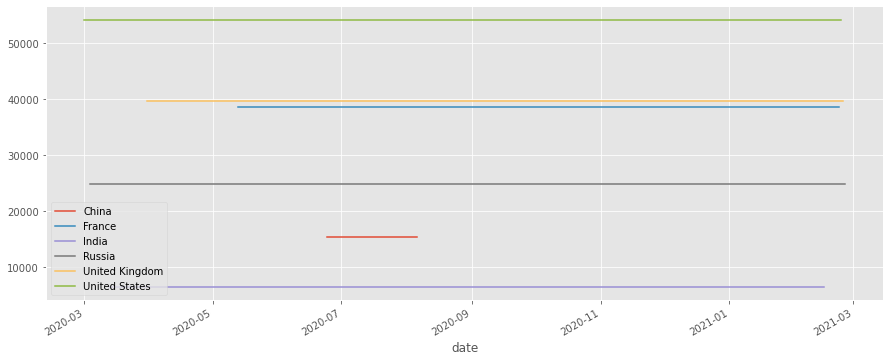

In [29]:
fig, ax = plt.subplots(figsize=(15,6))

for name, group in df_gdp.groupby('location'):
    group.plot(x='date',y='gdp_per_capita', ax=ax, label=name)

plt.show()

**We can't see any change in gdp over time because our time line is too short to detect any remarkable change.Thus we can't perform any forecasting on gdp.
To conclude, when forcasting something related to time we need to choose variables that strongly change over time scale to have a good history of the data to fit prediction models. In our case, we need more data at least 3 or 4 years to have that evolution over time.**